In [28]:
import os
import numpy as np
import matplotlib.pyplot as plt
import sys 
import mdtraj

NFF_PATH = '/home/wwj/Repo/playgrounds/NeuralForceField/'
ODE_PATH = '/home/wwj/Repo/projects/torchdiffeq/'

sys.path.insert(0, NFF_PATH)
sys.path.insert(0, ODE_PATH)
sys.path.insert(0, '../..')

import torch
from torch import nn
from torch.optim import Adam
from torchdiffeq import odeint_adjoint as odeint
from torchmd.ode import ODE
from torchmd.hamiltoinians import PairPot, MLP, LennardJones, Buck, LennardJones69
from torchmd.observable import DiffRDF
from torchmd.utils import dump_mov
from nglview import show_ase, show_file, show_mdtraj

from nff.utils.scatter import compute_grad
from nff.nn.layers import GaussianSmearing
from ase import Atoms
from math import sqrt

import matplotlib
matplotlib.rcParams.update({'font.size': 25})
matplotlib.rc('lines', linewidth=3, color='g')
matplotlib.rcParams['axes.linewidth'] = 2.0
matplotlib.rcParams['axes.linewidth'] = 2.0

matplotlib.rcParams["xtick.major.size"] = 6
matplotlib.rcParams["ytick.major.size"] = 6

matplotlib.rcParams["ytick.major.width"] = 2
matplotlib.rcParams["xtick.major.width"] = 2

matplotlib.rcParams['text.usetex'] = False

In [593]:
class NHODE(torch.nn.Module):

    def __init__(self, model, mass, target_momentum=4.0, num_chains=2, ttime = 10.0, dt= 0.005, device=0, dim=3):
        super().__init__()
        self.model = model  
        self.mass = torch.Tensor(mass).to(device)
    
        self.device = device 
        self.target_momentum = target_momentum
        self.ttime = ttime 
        self.N_dof = mass.shape[0] * dim
        self.target_ke = (0.5 * self.N_dof * self.target_momentum **2 )
        
        self.T = torch.Tensor( [self.target_momentum **2] ).to(device)
        self.num_chains = num_chains
        self.Q = np.array([1,
                   *[1]*(num_chains-1)]) 
        self.Q = torch.Tensor(self.Q).to(device)
        self.dim = dim
        
    def forward(self, t, state):
        # pq are the canonical momentum and position variables
        with torch.set_grad_enabled(True):
            
            N = self.N_dof
            
            pq = state[0]
            
            B = pq.shape[0]
            
            t.requires_grad = True
            pq.requires_grad = True
            t = t.expand(B, 1)
            
            p = pq[:, :N]
            q = pq[:, N:2* N].reshape(-1, self.dim)
            
            sys_ke = 0.5 * (p.reshape(-1, self.dim).pow(2) / self.mass[:, None]).sum(-1) 
            
            # definite all the virtual momentums 
            p_v = pq[:, -self.num_chains:]      
            u = self.model(q, t)
            
            dqdt = (p.reshape(-1, self.dim) / self.mass[:, None])#.reshape(-1)
            dpdt = -compute_grad(inputs=q, output=u).reshape(-1, self.dim) - p_v[:, [0]] * p / self.Q[0]
            
            u_sum = u.sum()
            dWdt = compute_grad(inputs=t, output=u_sum) #torch.Tensor( [0.0] ).to(self.device) 
            #print(u_sum.shape, t.shape)
            
            dpvdt_0 = 2 * (sys_ke - self.T * self.N_dof * 0.5) - p_v[:, 0] * p_v[:, 1]/ self.Q[1]
            dpvdt_mid = (p_v[:, :-2].pow(2) / self.Q[:-2] - self.T) - p_v[:, 2:]*p_v[:, 1:-1]/ self.Q[2:]
            dpvdt_last = p_v[:, -2].pow(2) / self.Q[-2] - self.T

        f = torch.cat((dpdt, dqdt, dpvdt_0[:, None], dpvdt_mid, dpvdt_last[:, None]), dim=1)
        dQdt = -dqdt * dpdt
        
        return (f, dWdt, dQdt)
    
class Harmonic1D(torch.nn.Module):
    def __init__(self):
        super(Harmonic1D, self).__init__()

    def forward(self, x):
        return 0.5 * x ** 2
    
nlr = nn.ReLU()    
class noneqharm_control(torch.nn.Module):
    def __init__(self, device, tau=100, k_0=1.0, k_tau=0.25, mu_0=0.0, mu_tau=1.0):
        super(noneqharm_control, self).__init__()
        self.tau = tau

        self.k_0 = k_0
        self.k_tau = k_tau
        self.mu_0 = mu_0
        self.mu_tau = mu_tau
        
        k_0 = torch.Tensor([k_0])
        k_tau = torch.Tensor([k_tau])
        
        
        self.F_0 = torch.log( k_0.sqrt() * sqrt(2 * np.pi) )
        self.F_tau = torch.log( k_tau.sqrt() * sqrt(2 * np.pi) )
        self.dF = self.F_tau - self.F_0
        # intialize control params
        self.device = device
        
        self.norm0 =  torch.zeros(1).to(device)
        
        #nlr = nn.ReLU()
        self.t_nn = nn.Sequential( nn.Linear(1, 32), 
                            nlr,
                            nn.Linear(32, 32),
                            nlr,
                            nn.Linear(32, 32),
                            nlr,
                            nn.Linear(32, 32),
                            nlr,
                            nn.Linear(32, 16),
                            nlr,
                            nn.Linear(16, 1)
                            )
        
        
#        self.init_control_param()
#              ------ control with cosine basis ------        
#     def init_control_param(self):
#         self.n_vec = torch.Tensor([i for i in range(self.n)]).to(self.device)
#         self.coeff = torch.Tensor( torch.rand(self.n) )
#         self.coeff[0] += 1
#         self.coeff = torch.nn.Parameter(self.coeff)
        
#     def control(self, t): 
#         control = torch.cos((np.pi /2 + self.n_vec * 2 * np.pi) * (t/self.tau).reshape(-1, 1)).pow(2)
#         coeff = self.coeff.abs() / self.coeff.abs().sum()
        
#         return (control * coeff.reshape(-1, self.n)).sum(1)
    
    def control(self, t):

        t_repr = t/self.tau 
        normalizer = 1 - t_repr
        norm0 = self.t_nn(self.norm0) 
        
        ptl = ( self.t_nn(t)/norm0) * normalizer
        
        return ptl

    def forward(self, x, t):
        H = 0.5 * self.k_0 * self.control(t) * (x - self.mu_0) ** 2 + 0.5 * self.k_tau * (1 - self.control(t)) * (x - self.mu_tau) ** 2 
        #print(self.control(t)[:, None].shape)
        #print( (x ** 2 ).shape)

        return H

In [548]:
# parametrize Neural time control that is smooth 


In [418]:
# convergence of Free Energy 
from sklearn.utils import shuffle


def compute_F(w):
    return -torch.log( torch.exp(-torch.Tensor(w)).mean() )


def estimate(W, sample_size=[5]):
    dF_mean = []
    dF_std = []

    for batch in sample_size:

        dF_stat = []

        for sample in range(40):
            W_traj = shuffle(W)
            dF = compute_F(W_traj[:batch])
            dF_stat.append(dF)

        std = np.array(dF_stat).std()
        mean = np.array(dF_stat).mean()

        dF_mean.append(mean)
        dF_std.append(std)
        
    dF_mean = np.array(dF_mean)
    dF_std = np.array(dF_std)

    plt.figure(figsize=(8,8))
    #plt.ylim(-.5, -.9)
    plt.plot(sample_size, dF_mean, label='-$\log < e^{-W} > $ ')
    plt.fill_between(sample_size, dF_mean - dF_std, dF_mean + dF_std, interpolate=True, alpha=0.2)
    #plt.xscale("log")
    plt.plot(sample_size, [f_x.model.dF ] * len(sample_size), linestyle='--', linewidth=2, c='black', 
            label='exact $\Delta F$')
    plt.legend()
    plt.show()

In [419]:
DEVICE = 2
num_chains = 3
tau = 10
dt = 0.025
t_len = int( tau / dt )

harm1d = noneqharm_control(tau=tau, k_tau=0.25, device=DEVICE, n=10).to(DEVICE)

f_x = NHODE(harm1d, 
            torch.Tensor([1.0]), 
            ttime=50.0, 
            num_chains=num_chains, 
            device=DEVICE,
            target_momentum=1.0,
            dim=1).to(DEVICE)

In [420]:
plt.figure(figsize=(8,4))
t = torch.Tensor([dt * i for i in range(t_len)]).to(DEVICE)

l_t = f_x.model.control(t[:, None].to(DEVICE))
plt.ylabel("$\lambda(t)$")
plt.plot(l_t.detach().cpu().numpy())

NameError: name 'norm0' is not defined

<Figure size 576x288 with 0 Axes>

In [415]:
t.shape

torch.Size([400])

In [279]:
# propagate non-equilibirum protocols

In [280]:
# B = 32

# print(dt * t_len)

# p_v = torch.empty(B, 3).normal_(mean=0,std=1)  # torch.Tensor([1.0] * num_chains)
# # sample position and momentum 
# q = torch.empty(B, 1).normal_(mean=0,std=1) 
# p = torch.empty(B, 1).normal_(mean=0,std=1)

# w = torch.zeros(B, 1).to(DEVICE)
# pq = torch.cat((p, q, p_v), dim=1).to(DEVICE)
# pq.requires_grad= True

# t = torch.Tensor([dt * i for i in range(t_len)]).to(DEVICE)
# t.requires_grad = True

# x, work = odeint(f_x, (pq, w), t, method='rk4')


# work[-1, :, 0].mean().backward()

In [287]:
Ws = []

for i in range(1):
    B = 2**2
    print(i)
    # sample position and momentum, p_v is virtual momenta 
    p_v = torch.empty(B, 3).normal_(mean=0,std=1)
    q = torch.empty(B, 1).normal_(mean=0,std=1) 
    p = torch.empty(B, 1).normal_(mean=0,std=1)

    W = torch.zeros(B, 1).to(DEVICE)
    Q = torch.zeros(B, 1).to(DEVICE)
    pq = torch.cat((p, q, p_v), dim=1).to(DEVICE)
    pq.requires_grad= True

    t = torch.Tensor([dt * i for i in range(t_len)]).to(DEVICE)
    t.requires_grad = True

    x, W_traj, Q_traj = odeint(f_x, (pq, W, Q), t, method='rk4')
    
    Ws.append(W_traj[-1, :, 0].detach().cpu().numpy())

0
tensor([[0.],
        [0.],
        [0.],
        [0.]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.],
        [0.],
        [0.],
        [0.]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.0083],
        [0.0083],
        [0.0083],
        [0.0083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.0083],
        [0.0083],
        [0.0083],
        [0.0083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.0167],
        [0.0167],
        [0.0167],
        [0.0167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.0167],
        [0.0167],
        [0.0167],
        [0.0167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.0250],
        [0.0250],
        [0.0250],
        [0.0250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.0250],
        [0.0250],
        [0.0250],
        [0.0250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.0250],
        [0.0250],
        [0.0250],
        [0.0250]], device='cuda:2', grad_fn=<Exp

tensor([[0.2750],
        [0.2750],
        [0.2750],
        [0.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.2750],
        [0.2750],
        [0.2750],
        [0.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.2750],
        [0.2750],
        [0.2750],
        [0.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.2833],
        [0.2833],
        [0.2833],
        [0.2833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.2833],
        [0.2833],
        [0.2833],
        [0.2833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.2917],
        [0.2917],
        [0.2917],
        [0.2917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.2917],
        [0.2917],
        [0.2917],
        [0.2917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.3000],
        [0.3000],
        [0.3000],
        [0.3000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.3000],
        [0.3000],
        [0.3000],
        [0.3000]],

tensor([[0.5417],
        [0.5417],
        [0.5417],
        [0.5417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.5500],
        [0.5500],
        [0.5500],
        [0.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.5500],
        [0.5500],
        [0.5500],
        [0.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.5500],
        [0.5500],
        [0.5500],
        [0.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.5500],
        [0.5500],
        [0.5500],
        [0.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.5583],
        [0.5583],
        [0.5583],
        [0.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.5583],
        [0.5583],
        [0.5583],
        [0.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.5667],
        [0.5667],
        [0.5667],
        [0.5667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.5667],
        [0.5667],
        [0.5667],
        [0.5667]],

tensor([[0.8250],
        [0.8250],
        [0.8250],
        [0.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.8250],
        [0.8250],
        [0.8250],
        [0.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.8333],
        [0.8333],
        [0.8333],
        [0.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.8333],
        [0.8333],
        [0.8333],
        [0.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.8417],
        [0.8417],
        [0.8417],
        [0.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.8417],
        [0.8417],
        [0.8417],
        [0.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.8500],
        [0.8500],
        [0.8500],
        [0.8500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.8500],
        [0.8500],
        [0.8500],
        [0.8500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[0.8500],
        [0.8500],
        [0.8500],
        [0.8500]],

tensor([[1.1083],
        [1.1083],
        [1.1083],
        [1.1083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.1083],
        [1.1083],
        [1.1083],
        [1.1083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.1167],
        [1.1167],
        [1.1167],
        [1.1167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.1167],
        [1.1167],
        [1.1167],
        [1.1167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.1250],
        [1.1250],
        [1.1250],
        [1.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.1250],
        [1.1250],
        [1.1250],
        [1.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.1250],
        [1.1250],
        [1.1250],
        [1.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.1250],
        [1.1250],
        [1.1250],
        [1.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.1333],
        [1.1333],
        [1.1333],
        [1.1333]],

tensor([[1.4000],
        [1.4000],
        [1.4000],
        [1.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.4000],
        [1.4000],
        [1.4000],
        [1.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.4083],
        [1.4083],
        [1.4083],
        [1.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.4083],
        [1.4083],
        [1.4083],
        [1.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.4167],
        [1.4167],
        [1.4167],
        [1.4167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.4167],
        [1.4167],
        [1.4167],
        [1.4167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.4250],
        [1.4250],
        [1.4250],
        [1.4250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.4250],
        [1.4250],
        [1.4250],
        [1.4250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.4250],
        [1.4250],
        [1.4250],
        [1.4250]],

tensor([[1.6833],
        [1.6833],
        [1.6833],
        [1.6833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.6833],
        [1.6833],
        [1.6833],
        [1.6833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.6917],
        [1.6917],
        [1.6917],
        [1.6917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.6917],
        [1.6917],
        [1.6917],
        [1.6917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.7000],
        [1.7000],
        [1.7000],
        [1.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.7000],
        [1.7000],
        [1.7000],
        [1.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.7000],
        [1.7000],
        [1.7000],
        [1.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.7000],
        [1.7000],
        [1.7000],
        [1.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.7083],
        [1.7083],
        [1.7083],
        [1.7083]],

tensor([[1.9750],
        [1.9750],
        [1.9750],
        [1.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.9750],
        [1.9750],
        [1.9750],
        [1.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.9750],
        [1.9750],
        [1.9750],
        [1.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.9750],
        [1.9750],
        [1.9750],
        [1.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.9833],
        [1.9833],
        [1.9833],
        [1.9833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.9833],
        [1.9833],
        [1.9833],
        [1.9833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.9917],
        [1.9917],
        [1.9917],
        [1.9917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[1.9917],
        [1.9917],
        [1.9917],
        [1.9917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.],
        [2.],
        [2.],
        [2.]], device='cuda:2'

tensor([[2.2500],
        [2.2500],
        [2.2500],
        [2.2500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.2583],
        [2.2583],
        [2.2583],
        [2.2583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.2583],
        [2.2583],
        [2.2583],
        [2.2583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.2667],
        [2.2667],
        [2.2667],
        [2.2667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.2667],
        [2.2667],
        [2.2667],
        [2.2667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.2750],
        [2.2750],
        [2.2750],
        [2.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.2750],
        [2.2750],
        [2.2750],
        [2.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.2750],
        [2.2750],
        [2.2750],
        [2.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.2750],
        [2.2750],
        [2.2750],
        [2.2750]],

tensor([[2.5333],
        [2.5333],
        [2.5333],
        [2.5333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.5417],
        [2.5417],
        [2.5417],
        [2.5417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.5417],
        [2.5417],
        [2.5417],
        [2.5417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.5500],
        [2.5500],
        [2.5500],
        [2.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.5500],
        [2.5500],
        [2.5500],
        [2.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.5500],
        [2.5500],
        [2.5500],
        [2.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.5500],
        [2.5500],
        [2.5500],
        [2.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.5583],
        [2.5583],
        [2.5583],
        [2.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.5583],
        [2.5583],
        [2.5583],
        [2.5583]],

tensor([[2.8167],
        [2.8167],
        [2.8167],
        [2.8167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.8250],
        [2.8250],
        [2.8250],
        [2.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.8250],
        [2.8250],
        [2.8250],
        [2.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.8250],
        [2.8250],
        [2.8250],
        [2.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.8250],
        [2.8250],
        [2.8250],
        [2.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.8333],
        [2.8333],
        [2.8333],
        [2.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.8333],
        [2.8333],
        [2.8333],
        [2.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.8417],
        [2.8417],
        [2.8417],
        [2.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[2.8417],
        [2.8417],
        [2.8417],
        [2.8417]],

tensor([[3.1000],
        [3.1000],
        [3.1000],
        [3.1000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.1000],
        [3.1000],
        [3.1000],
        [3.1000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.1083],
        [3.1083],
        [3.1083],
        [3.1083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.1083],
        [3.1083],
        [3.1083],
        [3.1083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.1167],
        [3.1167],
        [3.1167],
        [3.1167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.1167],
        [3.1167],
        [3.1167],
        [3.1167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.1250],
        [3.1250],
        [3.1250],
        [3.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.1250],
        [3.1250],
        [3.1250],
        [3.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.1250],
        [3.1250],
        [3.1250],
        [3.1250]],

tensor([[3.3833],
        [3.3833],
        [3.3833],
        [3.3833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.3917],
        [3.3917],
        [3.3917],
        [3.3917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.3917],
        [3.3917],
        [3.3917],
        [3.3917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.4000],
        [3.4000],
        [3.4000],
        [3.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.4000],
        [3.4000],
        [3.4000],
        [3.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.4000],
        [3.4000],
        [3.4000],
        [3.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.4000],
        [3.4000],
        [3.4000],
        [3.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.4083],
        [3.4083],
        [3.4083],
        [3.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.4083],
        [3.4083],
        [3.4083],
        [3.4083]],

tensor([[3.6667],
        [3.6667],
        [3.6667],
        [3.6667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.6667],
        [3.6667],
        [3.6667],
        [3.6667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.6750],
        [3.6750],
        [3.6750],
        [3.6750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.6750],
        [3.6750],
        [3.6750],
        [3.6750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.6750],
        [3.6750],
        [3.6750],
        [3.6750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.6750],
        [3.6750],
        [3.6750],
        [3.6750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.6833],
        [3.6833],
        [3.6833],
        [3.6833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.6833],
        [3.6833],
        [3.6833],
        [3.6833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.6917],
        [3.6917],
        [3.6917],
        [3.6917]],

tensor([[3.9500],
        [3.9500],
        [3.9500],
        [3.9500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.9500],
        [3.9500],
        [3.9500],
        [3.9500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.9583],
        [3.9583],
        [3.9583],
        [3.9583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.9583],
        [3.9583],
        [3.9583],
        [3.9583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.9667],
        [3.9667],
        [3.9667],
        [3.9667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.9667],
        [3.9667],
        [3.9667],
        [3.9667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.9750],
        [3.9750],
        [3.9750],
        [3.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.9750],
        [3.9750],
        [3.9750],
        [3.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[3.9750],
        [3.9750],
        [3.9750],
        [3.9750]],

tensor([[4.2500],
        [4.2500],
        [4.2500],
        [4.2500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.2500],
        [4.2500],
        [4.2500],
        [4.2500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.2583],
        [4.2583],
        [4.2583],
        [4.2583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.2583],
        [4.2583],
        [4.2583],
        [4.2583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.2667],
        [4.2667],
        [4.2667],
        [4.2667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.2667],
        [4.2667],
        [4.2667],
        [4.2667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.2750],
        [4.2750],
        [4.2750],
        [4.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.2750],
        [4.2750],
        [4.2750],
        [4.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.2750],
        [4.2750],
        [4.2750],
        [4.2750]],

tensor([[4.5417],
        [4.5417],
        [4.5417],
        [4.5417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.5417],
        [4.5417],
        [4.5417],
        [4.5417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.5500],
        [4.5500],
        [4.5500],
        [4.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.5500],
        [4.5500],
        [4.5500],
        [4.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.5500],
        [4.5500],
        [4.5500],
        [4.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.5500],
        [4.5500],
        [4.5500],
        [4.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.5583],
        [4.5583],
        [4.5583],
        [4.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.5583],
        [4.5583],
        [4.5583],
        [4.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.5667],
        [4.5667],
        [4.5667],
        [4.5667]],

tensor([[4.8250],
        [4.8250],
        [4.8250],
        [4.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.8250],
        [4.8250],
        [4.8250],
        [4.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.8250],
        [4.8250],
        [4.8250],
        [4.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.8250],
        [4.8250],
        [4.8250],
        [4.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.8333],
        [4.8333],
        [4.8333],
        [4.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.8333],
        [4.8333],
        [4.8333],
        [4.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.8417],
        [4.8417],
        [4.8417],
        [4.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.8417],
        [4.8417],
        [4.8417],
        [4.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[4.8500],
        [4.8500],
        [4.8500],
        [4.8500]],

tensor([[5.1000],
        [5.1000],
        [5.1000],
        [5.1000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.1000],
        [5.1000],
        [5.1000],
        [5.1000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.1083],
        [5.1083],
        [5.1083],
        [5.1083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.1083],
        [5.1083],
        [5.1083],
        [5.1083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.1167],
        [5.1167],
        [5.1167],
        [5.1167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.1167],
        [5.1167],
        [5.1167],
        [5.1167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.1250],
        [5.1250],
        [5.1250],
        [5.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.1250],
        [5.1250],
        [5.1250],
        [5.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.1250],
        [5.1250],
        [5.1250],
        [5.1250]],

tensor([[5.4000],
        [5.4000],
        [5.4000],
        [5.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.4000],
        [5.4000],
        [5.4000],
        [5.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.4000],
        [5.4000],
        [5.4000],
        [5.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.4000],
        [5.4000],
        [5.4000],
        [5.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.4083],
        [5.4083],
        [5.4083],
        [5.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.4083],
        [5.4083],
        [5.4083],
        [5.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.4167],
        [5.4167],
        [5.4167],
        [5.4167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.4167],
        [5.4167],
        [5.4167],
        [5.4167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.4250],
        [5.4250],
        [5.4250],
        [5.4250]],

tensor([[5.6833],
        [5.6833],
        [5.6833],
        [5.6833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.6833],
        [5.6833],
        [5.6833],
        [5.6833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.6917],
        [5.6917],
        [5.6917],
        [5.6917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.6917],
        [5.6917],
        [5.6917],
        [5.6917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.7000],
        [5.7000],
        [5.7000],
        [5.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.7000],
        [5.7000],
        [5.7000],
        [5.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.7000],
        [5.7000],
        [5.7000],
        [5.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.7000],
        [5.7000],
        [5.7000],
        [5.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.7083],
        [5.7083],
        [5.7083],
        [5.7083]],

tensor([[5.9750],
        [5.9750],
        [5.9750],
        [5.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.9750],
        [5.9750],
        [5.9750],
        [5.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.9833],
        [5.9833],
        [5.9833],
        [5.9833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.9833],
        [5.9833],
        [5.9833],
        [5.9833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.9917],
        [5.9917],
        [5.9917],
        [5.9917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[5.9917],
        [5.9917],
        [5.9917],
        [5.9917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.],
        [6.],
        [6.],
        [6.]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.],
        [6.],
        [6.],
        [6.]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.],
        [6.],
        [6.],
        [6.]], device='cuda:2', grad_fn=<ExpandBackward>)
tens

tensor([[6.2583],
        [6.2583],
        [6.2583],
        [6.2583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.2583],
        [6.2583],
        [6.2583],
        [6.2583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.2667],
        [6.2667],
        [6.2667],
        [6.2667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.2667],
        [6.2667],
        [6.2667],
        [6.2667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.2750],
        [6.2750],
        [6.2750],
        [6.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.2750],
        [6.2750],
        [6.2750],
        [6.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.2750],
        [6.2750],
        [6.2750],
        [6.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.2750],
        [6.2750],
        [6.2750],
        [6.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.2833],
        [6.2833],
        [6.2833],
        [6.2833]],

tensor([[6.5500],
        [6.5500],
        [6.5500],
        [6.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.5500],
        [6.5500],
        [6.5500],
        [6.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.5500],
        [6.5500],
        [6.5500],
        [6.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.5500],
        [6.5500],
        [6.5500],
        [6.5500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.5583],
        [6.5583],
        [6.5583],
        [6.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.5583],
        [6.5583],
        [6.5583],
        [6.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.5667],
        [6.5667],
        [6.5667],
        [6.5667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.5667],
        [6.5667],
        [6.5667],
        [6.5667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.5750],
        [6.5750],
        [6.5750],
        [6.5750]],

tensor([[6.8250],
        [6.8250],
        [6.8250],
        [6.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.8250],
        [6.8250],
        [6.8250],
        [6.8250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.8333],
        [6.8333],
        [6.8333],
        [6.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.8333],
        [6.8333],
        [6.8333],
        [6.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.8417],
        [6.8417],
        [6.8417],
        [6.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.8417],
        [6.8417],
        [6.8417],
        [6.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.8500],
        [6.8500],
        [6.8500],
        [6.8500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.8500],
        [6.8500],
        [6.8500],
        [6.8500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[6.8500],
        [6.8500],
        [6.8500],
        [6.8500]],

tensor([[7.1250],
        [7.1250],
        [7.1250],
        [7.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.1250],
        [7.1250],
        [7.1250],
        [7.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.1250],
        [7.1250],
        [7.1250],
        [7.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.1250],
        [7.1250],
        [7.1250],
        [7.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.1333],
        [7.1333],
        [7.1333],
        [7.1333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.1333],
        [7.1333],
        [7.1333],
        [7.1333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.1417],
        [7.1417],
        [7.1417],
        [7.1417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.1417],
        [7.1417],
        [7.1417],
        [7.1417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.1500],
        [7.1500],
        [7.1500],
        [7.1500]],

tensor([[7.4000],
        [7.4000],
        [7.4000],
        [7.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.4083],
        [7.4083],
        [7.4083],
        [7.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.4083],
        [7.4083],
        [7.4083],
        [7.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.4167],
        [7.4167],
        [7.4167],
        [7.4167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.4167],
        [7.4167],
        [7.4167],
        [7.4167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.4250],
        [7.4250],
        [7.4250],
        [7.4250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.4250],
        [7.4250],
        [7.4250],
        [7.4250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.4250],
        [7.4250],
        [7.4250],
        [7.4250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.4250],
        [7.4250],
        [7.4250],
        [7.4250]],

tensor([[7.7000],
        [7.7000],
        [7.7000],
        [7.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.7000],
        [7.7000],
        [7.7000],
        [7.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.7083],
        [7.7083],
        [7.7083],
        [7.7083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.7083],
        [7.7083],
        [7.7083],
        [7.7083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.7167],
        [7.7167],
        [7.7167],
        [7.7167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.7167],
        [7.7167],
        [7.7167],
        [7.7167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.7250],
        [7.7250],
        [7.7250],
        [7.7250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.7250],
        [7.7250],
        [7.7250],
        [7.7250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[7.7250],
        [7.7250],
        [7.7250],
        [7.7250]],

tensor([[8.],
        [8.],
        [8.],
        [8.]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.],
        [8.],
        [8.],
        [8.]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.],
        [8.],
        [8.],
        [8.]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.],
        [8.],
        [8.],
        [8.]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.0083],
        [8.0083],
        [8.0083],
        [8.0083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.0083],
        [8.0083],
        [8.0083],
        [8.0083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.0167],
        [8.0167],
        [8.0167],
        [8.0167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.0167],
        [8.0167],
        [8.0167],
        [8.0167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.0250],
        [8.0250],
        [8.0250],
        [8.0250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.0250],
  

tensor([[8.2750],
        [8.2750],
        [8.2750],
        [8.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.2750],
        [8.2750],
        [8.2750],
        [8.2750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.2833],
        [8.2833],
        [8.2833],
        [8.2833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.2833],
        [8.2833],
        [8.2833],
        [8.2833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.2917],
        [8.2917],
        [8.2917],
        [8.2917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.2917],
        [8.2917],
        [8.2917],
        [8.2917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.3000],
        [8.3000],
        [8.3000],
        [8.3000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.3000],
        [8.3000],
        [8.3000],
        [8.3000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.3000],
        [8.3000],
        [8.3000],
        [8.3000]],

tensor([[8.5583],
        [8.5583],
        [8.5583],
        [8.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.5583],
        [8.5583],
        [8.5583],
        [8.5583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.5667],
        [8.5667],
        [8.5667],
        [8.5667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.5667],
        [8.5667],
        [8.5667],
        [8.5667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.5750],
        [8.5750],
        [8.5750],
        [8.5750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.5750],
        [8.5750],
        [8.5750],
        [8.5750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.5750],
        [8.5750],
        [8.5750],
        [8.5750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.5750],
        [8.5750],
        [8.5750],
        [8.5750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.5833],
        [8.5833],
        [8.5833],
        [8.5833]],

tensor([[8.8333],
        [8.8333],
        [8.8333],
        [8.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.8333],
        [8.8333],
        [8.8333],
        [8.8333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.8417],
        [8.8417],
        [8.8417],
        [8.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.8417],
        [8.8417],
        [8.8417],
        [8.8417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.8500],
        [8.8500],
        [8.8500],
        [8.8500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.8500],
        [8.8500],
        [8.8500],
        [8.8500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.8500],
        [8.8500],
        [8.8500],
        [8.8500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.8500],
        [8.8500],
        [8.8500],
        [8.8500]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[8.8583],
        [8.8583],
        [8.8583],
        [8.8583]],

tensor([[9.1250],
        [9.1250],
        [9.1250],
        [9.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.1250],
        [9.1250],
        [9.1250],
        [9.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.1250],
        [9.1250],
        [9.1250],
        [9.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.1250],
        [9.1250],
        [9.1250],
        [9.1250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.1333],
        [9.1333],
        [9.1333],
        [9.1333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.1333],
        [9.1333],
        [9.1333],
        [9.1333]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.1417],
        [9.1417],
        [9.1417],
        [9.1417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.1417],
        [9.1417],
        [9.1417],
        [9.1417]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.1500],
        [9.1500],
        [9.1500],
        [9.1500]],

tensor([[9.4000],
        [9.4000],
        [9.4000],
        [9.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.4000],
        [9.4000],
        [9.4000],
        [9.4000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.4083],
        [9.4083],
        [9.4083],
        [9.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.4083],
        [9.4083],
        [9.4083],
        [9.4083]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.4167],
        [9.4167],
        [9.4167],
        [9.4167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.4167],
        [9.4167],
        [9.4167],
        [9.4167]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.4250],
        [9.4250],
        [9.4250],
        [9.4250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.4250],
        [9.4250],
        [9.4250],
        [9.4250]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.4250],
        [9.4250],
        [9.4250],
        [9.4250]],

tensor([[9.6750],
        [9.6750],
        [9.6750],
        [9.6750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.6833],
        [9.6833],
        [9.6833],
        [9.6833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.6833],
        [9.6833],
        [9.6833],
        [9.6833]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.6917],
        [9.6917],
        [9.6917],
        [9.6917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.6917],
        [9.6917],
        [9.6917],
        [9.6917]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.7000],
        [9.7000],
        [9.7000],
        [9.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.7000],
        [9.7000],
        [9.7000],
        [9.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.7000],
        [9.7000],
        [9.7000],
        [9.7000]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.7000],
        [9.7000],
        [9.7000],
        [9.7000]],

tensor([[9.9583],
        [9.9583],
        [9.9583],
        [9.9583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.9583],
        [9.9583],
        [9.9583],
        [9.9583]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.9667],
        [9.9667],
        [9.9667],
        [9.9667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.9667],
        [9.9667],
        [9.9667],
        [9.9667]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.9750],
        [9.9750],
        [9.9750],
        [9.9750]], device='cuda:2', grad_fn=<ExpandBackward>)
tensor([[9.9750],
        [9.9750],
        [9.9750],
        [9.9750]], device='cuda:2', grad_fn=<ExpandBackward>)


In [59]:
W_traj.shape

torch.Size([100, 65536, 1])

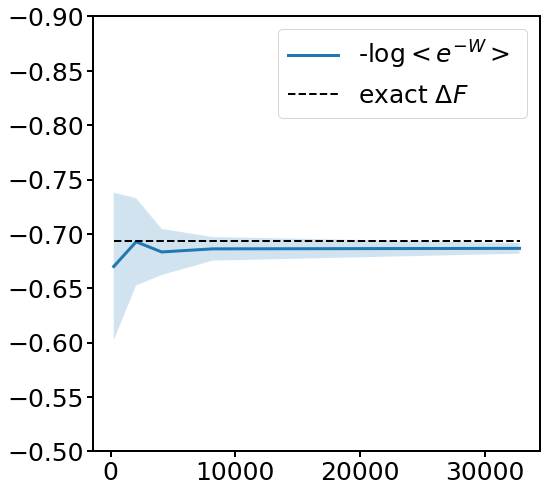

In [23]:
#dE = work + e_traj

#plt.hist(e_traj[-1, :, 0].detach().cpu().numpy())
#plt.hist(work[-1, :, 0].detach().cpu().numpy())

# plt.hist(dE[-1, :, 0].detach().cpu().numpy(), bins=20)
# plt.yscale("log")
# plt.show()

estimate(W_traj[-1, :, 0].detach().cpu().numpy(), sample_size=[2**8, 2**11, 2**12, 2**13, 2 **15])

In [423]:
# intial protocol 
# visualize protocols 
plt.figure(figsize=(8,4))
l_t = f_x.model.control(t[:, None])
plt.ylabel("$\lambda(t)$")
plt.plot(l_t.detach().cpu().numpy())

NameError: name 'norm0' is not defined

<Figure size 576x288 with 0 Axes>

# Optimize protocols 

In [655]:
# Initialize Model 
DEVICE = 2
num_chains = 3
tau = 5
dt = 0.05
t_len = int( tau / dt )

harm1d = noneqharm_control(tau=tau, k_tau=1.0, device=DEVICE, mu_tau=2.0).to(DEVICE)

f_x = NHODE(harm1d, 
            torch.Tensor([1.0]), 
            ttime=50.0, 
            num_chains=num_chains, 
            device=DEVICE,
            target_momentum=1.0,
            dim=1).to(DEVICE)


In [656]:
# initialize optimizer 
optimizer = torch.optim.Adam(list( harm1d.parameters() ), lr=3e-3
)

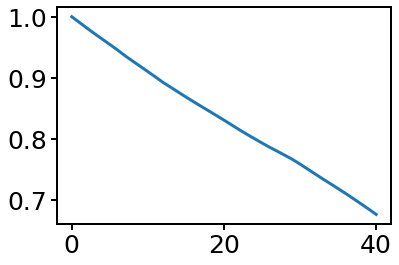

In [657]:
l_t = f_x.model.control(t[:, None])
plt.plot(l_t.detach().cpu().numpy())

In [658]:
loss_log = []

/home/wwj/anaconda3/envs/nff/lib/python3.7/site-packages/ipykernel_launcher.py:37: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.


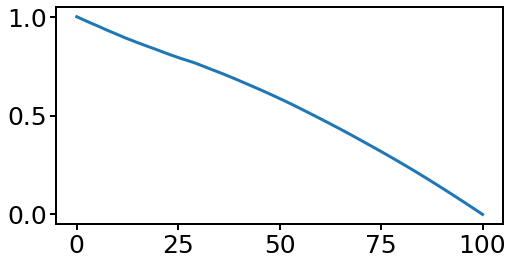

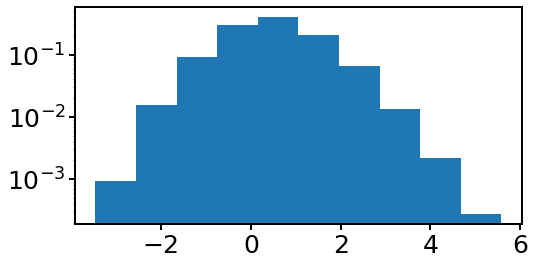

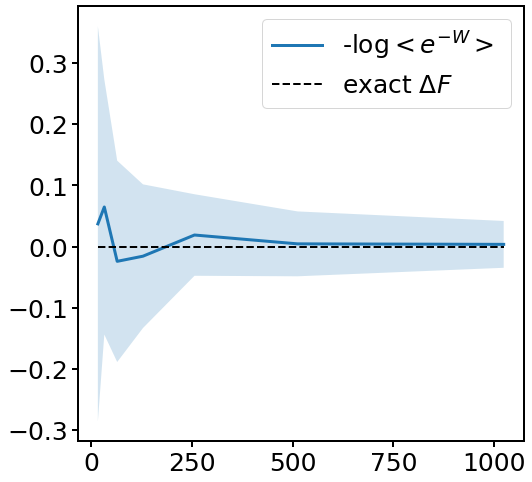

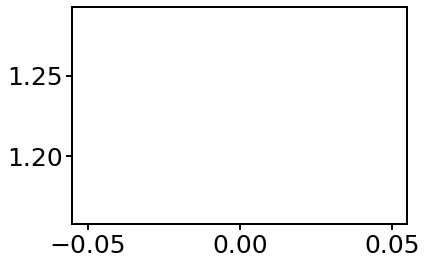

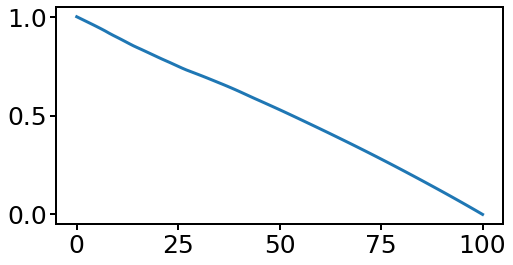

...

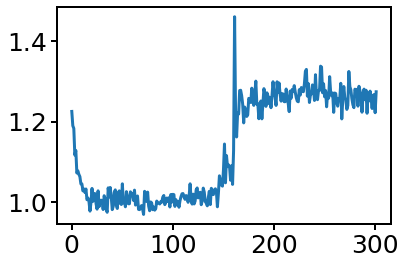

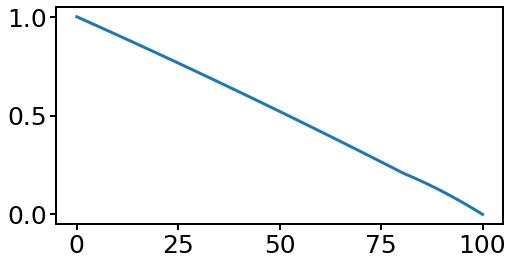

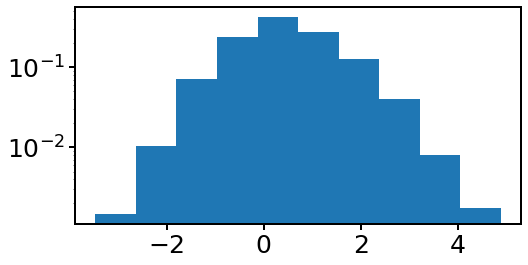

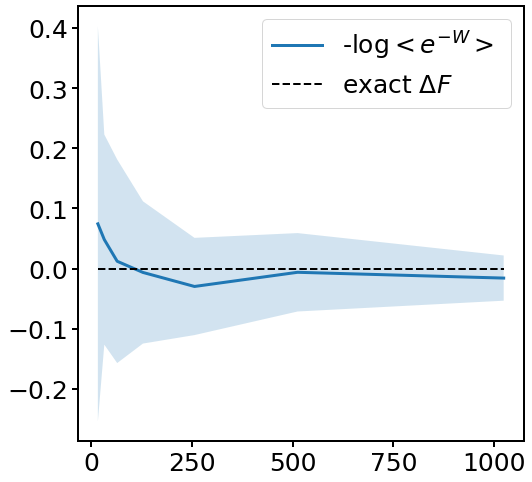

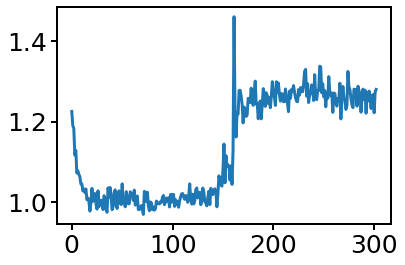

KeyboardInterrupt: 

In [659]:
loss_log = []
for i in range(2000):
    B = 2**14

    # sample position and momentum, p_v is virtual momenta 
    p_v = torch.empty(B, 3).normal_(mean=0,std=1)
    q = torch.empty(B, 1).normal_(mean=0,std=1) 
    p = torch.empty(B, 1).normal_(mean=0,std=1)

    w = torch.zeros(B, 1).to(DEVICE)
    Q = torch.zeros(B, 1).to(DEVICE)
    pq = torch.cat((p, q, p_v), dim=1).to(DEVICE)
    pq.requires_grad= True

    t = torch.Tensor([dt * i for i in range(t_len + 1)]).to(DEVICE)
    t.requires_grad = True

    x, work, Q_traj = odeint(f_x, (pq, w, Q), t, method='rk4')
    
    # propage loss to nudge coefficients 
    loss = work[-1, :, 0].pow(2).mean()
    loss.backward()
    
    plt.figure(figsize=(8,4))
    l_t = f_x.model.control(t[:, None])
    plt.plot(l_t.detach().cpu().numpy())
    
    loss_log.append(loss.item())
    
    optimizer.step()
    optimizer.zero_grad()

    #print(f_x.model.coeff.data)
    # plot work distributions 
    plt.figure(figsize=(8,4))
    plt.title("".format(i))
    plt.hist( work[-1].detach().cpu().numpy(), bins=10, normed=True)
    #plt.yscale("log")
    #plt.xlim(-8, 3)
    plt.show()
     
    # get work 
    W = work[-1, :, 0].detach().cpu().numpy()
    estimate(W, sample_size=[16, 32, 64, 128, 256, 512, 1024] )
    
    plt.plot(loss_log)
    plt.show()

In [516]:
t

tensor([0.0000, 0.1000, 0.2000, 0.3000, 0.4000, 0.5000, 0.6000, 0.7000, 0.8000,
        0.9000], device='cuda:2', requires_grad=True)

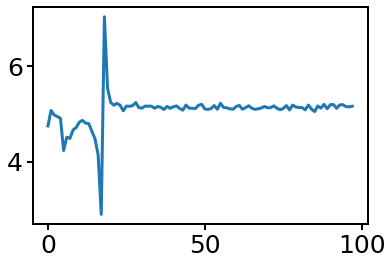

In [643]:
plt.plot(loss_log)
plt.show()
#plt.yscale("log")

/home/wwj/anaconda3/envs/nff/lib/python3.7/site-packages/ipykernel_launcher.py:2: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  


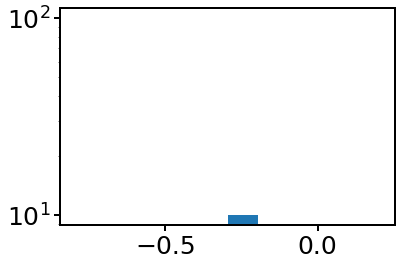

In [333]:
# 
plt.hist( work[-1].detach().cpu().numpy(), bins=10, normed=True)
plt.yscale("log")
plt.show()

In [19]:
# compute dissipation 
# compute heat 

In [ ]:
# 

In [16]:
f_x.model.coeff.grad

tensor([-11800795.0000,  -6375413.5000,  13196302.0000,  14071164.0000,
          9006632.0000], device='cuda:0')

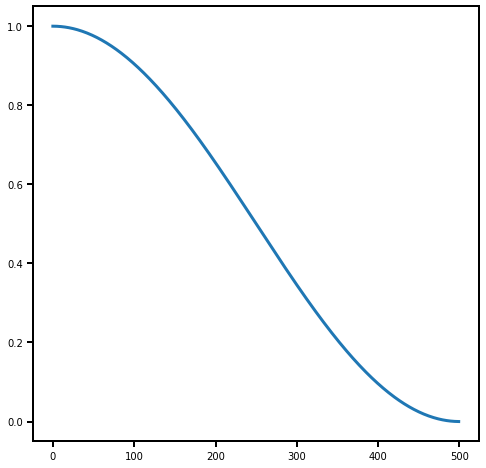

In [20]:
# visualize protocols 
plt.figure(figsize=(8,8))
l_t = f_x.model.control(t)
plt.plot(l_t.detach().cpu().numpy())

/home/wwj/anaconda3/envs/nff/lib/python3.7/site-packages/ipykernel_launcher.py:1: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  """Entry point for launching an IPython kernel.


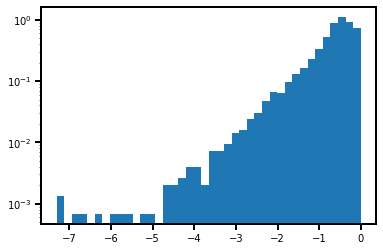

In [21]:
plt.hist( work[-1].detach().cpu().numpy(), bins=40, normed=True)
plt.yscale("log")
plt.show()

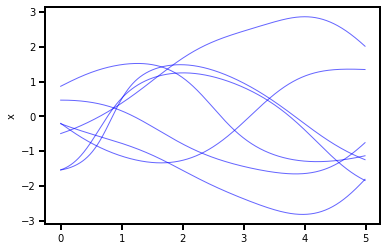

In [44]:


#plt.plot( t.detach().cpu().numpy(), x[:, ::, 1].detach().cpu().numpy(), linewidth=0.2, #color='#1f77b4',
#                 c='b', alpha=0.05)

plt.plot( t.detach().cpu().numpy(), x[:, ::10, 1].detach().cpu().numpy(), linewidth=1, color='b', alpha=0.6)

#plt.plot( t.detach().cpu().numpy(), x[:, ::100, 0].detach().cpu().numpy(), linewidth=1, color='r', alpha=0.6)

#plt.plot( t.detach().cpu().numpy(), l_t.detach().cpu().numpy())

plt.ylabel("x")

plt.show()

In [128]:
W_traj = []
for i in range(B):
    qt =  x[:, i, 1].detach().reshape(-1)
    qt.requires_grad = True
    u = f_x.model(qt, t)
    dh = compute_grad(inputs=t, output=u)
    W = (dh.detach().cpu().numpy() * dt).sum()
    
    W_traj.append(W)

In [8]:


W = work[-1, :, 0].detach().cpu().numpy()

/home/wwj/anaconda3/envs/nff/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  """
/home/wwj/anaconda3/envs/nff/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  


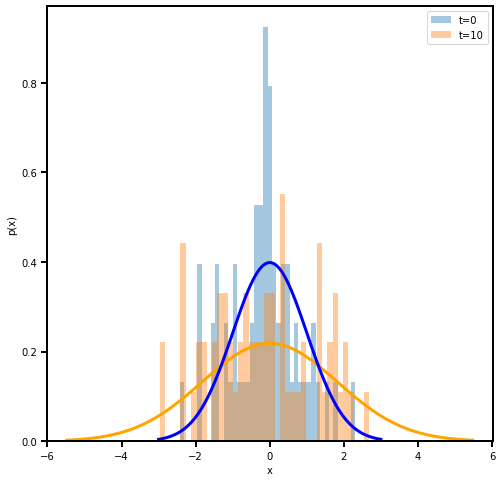

In [45]:
import math
import scipy.stats as stats
plt.figure(figsize=(8,8))

plt.hist(x[0, :, 1].detach().cpu().numpy(),bins=40, alpha=0.4, normed=True, label='t=0')
plt.hist(x[-1, :, 1].detach().cpu().numpy(),bins=40, alpha=0.4, normed=True, label='t=10')

plt.legend()
plt.xlabel("x")
plt.ylabel("p(x)")


mu = 0
variance = sqrt(1/0.09)
sigma = math.sqrt(variance)
var = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)
plt.plot(var, stats.norm.pdf(var, mu, sigma), label='theory', color='orange')

mu = 0
variance = sqrt(1)
sigma = math.sqrt(variance)
var = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)
plt.plot(var, stats.norm.pdf(var, mu, sigma), label='theory', color='b')

plt.show()

In [359]:
F = compute_F(W)

In [362]:
W.shape

(16384,)

In [361]:
f_x.model.dF

tensor([-1.2040])

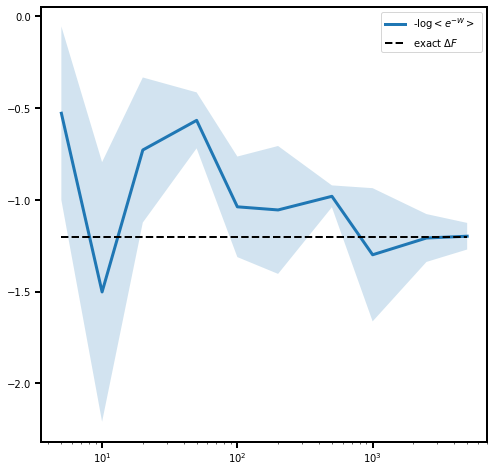

In [379]:
B

32768

In [332]:
# construct basis set for control protocols 

In [267]:
x = torch.linspace(0, 1, 100).reshape()

In [272]:
x.shape

torch.Size([100])

In [64]:
n = 5
n_vec = torch.Tensor([i for i in range(n)])

t = torch.Tensor([0.1]).reshape(-1)
t = torch.linspace(0,1, 100)

In [65]:
control = torch.cos((np.pi /2 + n_vec * 2 * np.pi) * t.reshape(-1, 1)).pow(2) 

# intialize control variables 
coeff = torch.Tensor( torch.rand(n) )
coeff[0] += 1

# take absolute values 
coeff = coeff.abs() / coeff.abs().sum()

protocol = (control * coeff.reshape(-1, n)).sum(1)

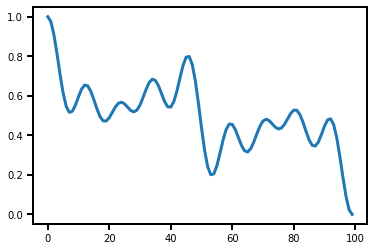

In [66]:
plt.plot( protocol.numpy())


In [ ]:
class noneqharm_control(torch.nn.Module):
    def __init__(self, tau=100, k_0=1.0, k_tau=0.25, n=5):
        super(noneqharm, self).__init__()
        self.tau = tau
        self.n = n
        self.k_0 = k_0
        self.k_tau = k_tau
        
        k_0 = torch.Tensor([k_0])
        k_tau = torch.Tensor([k_tau])
        
        self.F_0 = torch.log( k_0.sqrt() * sqrt(2 * np.pi) )
        self.F_tau = torch.log( k_tau.sqrt() * sqrt(2 * np.pi) )
        self.dF = self.F_tau - self.F_0
        # intialize control params 
        self.init_control_param()
        
    def init_control_param(self):
        n_vec = torch.Tensor([i for i in range(self.n)])
        self.coeff = torch.Tensor( torch.rand(n) )
        self.coeff[0] += 1
        self.coeff = torch.nn.Parameter(self.coeff)
        
    def control(self, t): 
        coeff = self.coeff.abs() / coeff.abs().sum()
        return (control * coeff.reshape(-1, n)).sum(1)

    def forward(self, x, t):
        return 0.5 * self.k_0 * self.control(t) * x ** 2 + 0.5 * self.k_tau * (1 - self.control(t)) * x ** 2 

In [287]:
protocol = (control * coeffs.reshape(-1, 4)).sum(1)

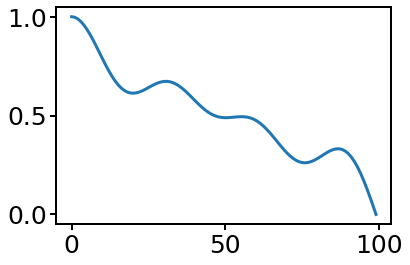

In [289]:
plt.plot( protocol.cpu())